In [1]:
#!python -m pip install gym
#!python -m pip install tf-agents
#!python -m pip install gym[atari]
#!python -m pip install autorom
#!AutoROM -y
#!python -m pip install opencv-python
#!pip install autorom[accept-rom-license]
#!pip install "gymnasium[atari, accept-rom-license]"
#!apt update
#!apt install -y xvfb
#!pip install -U pyvirtualdisplay
#!pip install ale-py
#!pip install gym gym[atari] autorom[accept-rom-license] tf-agents

In [2]:
import gym
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import animation
import random
import tensorflow as tf
from gym.wrappers import TimeLimit
from tf_agents.environments import suite_gym
from tf_agents.environments import suite_atari
from tf_agents.environments.atari_preprocessing import AtariPreprocessing
from tf_agents.environments.atari_wrappers import FrameStack4
from tf_agents.environments.tf_py_environment import TFPyEnvironment
from tf_agents.networks.q_network import QNetwork
from tf_agents.agents.dqn.dqn_agent import DqnAgent
from tf_agents.replay_buffers import tf_uniform_replay_buffer
from tf_agents.eval.metric_utils import log_metrics
import logging
from tf_agents.metrics import tf_metrics
from tf_agents.drivers.dynamic_step_driver import DynamicStepDriver
from tf_agents.policies.random_tf_policy import RandomTFPolicy
from tf_agents.utils.common import function
import matplotlib as mpl
import matplotlib.animation as animation
import PIL
import os
from tf_agents.agents.dqn import dqn_agent
from tf_agents.drivers import dynamic_step_driver
from tf_agents.environments import suite_gym
from tf_agents.environments import tf_py_environment
from tf_agents.eval import metric_utils
from tf_agents.metrics import tf_metrics
from tf_agents.networks import q_network
from tf_agents.policies import policy_saver
from tf_agents.policies import py_tf_eager_policy
from tf_agents.policies import random_tf_policy
from tf_agents.replay_buffers import tf_uniform_replay_buffer
from tf_agents.trajectories import trajectory
from tf_agents.utils import common


2023-06-15 03:27:15.836910: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-06-15 03:27:16.967765: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/conda/lib/python3.7/site-packages/cv2/../../lib64:/usr/local/cuda/lib64:/usr/local/nccl2/lib:/usr/local/cuda/extras/CUPTI/lib64
2023-06-15 03:27:16.967883: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIB

In [3]:
import gym
# Create a Gym environment for Space Invaders
env = gym.make('MsPacman-v4')

In [4]:
import numpy as np
import os

# to make this notebook's output stable across runs
#np.random.seed(42)
#tf.random.set_seed(42)

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

# To get smooth animations
import matplotlib.animation as animation
mpl.rc('animation', html='jshtml')

# Where to save the figures
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "rl"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)
os.makedirs(IMAGES_PATH, exist_ok=True)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

In [5]:
# Observation and action space 
obs_space = env.observation_space
action_space = env.action_space
print("The observation space: {}".format(obs_space))
print("The action space: {}".format(action_space))

The observation space: Box(0, 255, (210, 160, 3), uint8)
The action space: Discrete(9)


In [6]:
import matplotlib.pyplot as plt 

# reset the environment and see the initial observation
obs = env.reset()
print("The initial observation is {}".format(obs))

# Sample a random action from the entire action space
random_action = env.action_space.sample()

# # Take the action and get the new observation space
new_obs, reward, done, info = env.step(random_action)
print("The new observation is {}".format(new_obs))

The initial observation is [[[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[228 111 111]
  [228 111 111]
  [228 111 111]
  ...
  [228 111 111]
  [228 111 111]
  [228 111 111]]

 [[228 111 111]
  [228 111 111]
  [228 111 111]
  ...
  [228 111 111]
  [228 111 111]
  [228 111 111]]

 ...

 [[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]]
The new observation is [[[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[228 111 111]
  [228 111 111]
  [228 111 111]
  ...
  [228 111 111]
  [228 111 111]
  [228 111 111]]

 [[228 111 111]
  [228 111 111]
  [228 111 111]
  ...
  [228 111 111]
  [228 111 111]
  [228 111 111]]

 ...

 [

In [7]:
import numpy as np
env.step(np.array(1) )

(array([[[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],
 
        [[228, 111, 111],
         [228, 111, 111],
         [228, 111, 111],
         ...,
         [228, 111, 111],
         [228, 111, 111],
         [228, 111, 111]],
 
        [[228, 111, 111],
         [228, 111, 111],
         [228, 111, 111],
         ...,
         [228, 111, 111],
         [228, 111, 111],
         [228, 111, 111]],
 
        ...,
 
        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],
 
        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],
 
        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
  

(-0.5, 159.5, 209.5, -0.5)

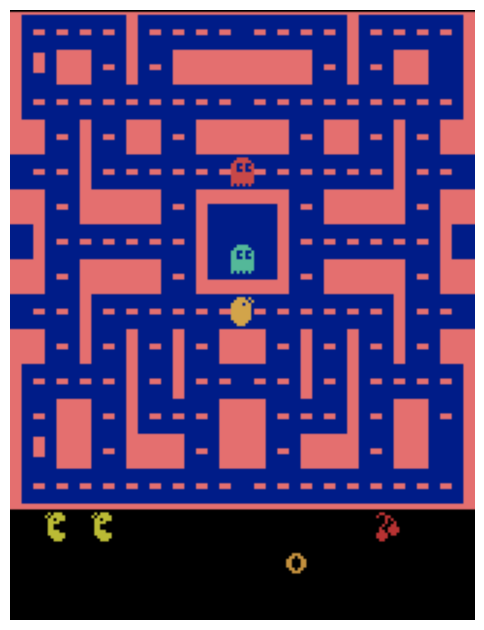

In [8]:
import matplotlib.pyplot as plt
%matplotlib inline
img = env.render(mode="rgb_array")
plt.figure(figsize=(6, 8))
plt.imshow(img)
plt.axis("off")

In [9]:
from tf_agents.environments import suite_gym, ActionRepeat, TimeLimit 
myLimRepEnv=suite_gym.load('MsPacman-v4',
        gym_env_wrappers=[lambda env: TimeLimit(env,duration=10000)],
        env_wrappers=[lambda env: ActionRepeat(env,times=4)])

In [10]:
from tf_agents.environments import suite_atari
from tf_agents.environments.atari_preprocessing import AtariPreprocessing
from tf_agents.environments.atari_wrappers import FrameStack4
max_episode_steps = 50000 # <=> 108k ALE frames since 1 step = 4 frames
environment_name = "MsPacman-v4"
env = suite_atari.load(
    environment_name,
    max_episode_steps=max_episode_steps,
    gym_env_wrappers=[AtariPreprocessing, FrameStack4])

In [11]:
from tf_agents.environments.tf_py_environment import TFPyEnvironment
tf_env = TFPyEnvironment(env)

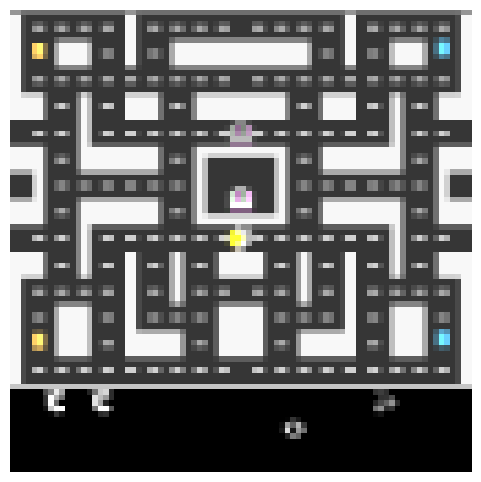

In [12]:
#env.seed(42)
env.reset()
time_step = env.step(np.array(1)) # FIRE
for _ in range(4):
    time_step = env.step(np.array(3)) # LEFT
def plot_observation(obs):
    # Since there are only 3 color channels, you cannot display 4 frames
    # with one primary color per frame. So this code computes the delta between
    # the current frame and the mean of the other frames, and it adds this delta
    # to the red and blue channels to get a pink color for the current frame.
    obs = obs.astype(np.float32)
    img = obs[..., :3]
    current_frame_delta = np.maximum(obs[..., 3] - obs[..., :3].mean(axis=-1), 0.)
    img[..., 0] += current_frame_delta
    img[..., 2] += current_frame_delta
    img = np.clip(img / 150, 0, 1)
    plt.imshow(img)
    plt.axis("off")
plt.figure(figsize=(6, 6))
plot_observation(time_step.observation)
plt.show()

In [13]:
from tf_agents.networks.q_network import QNetwork
preprocessing_layer = tf.keras.layers.Lambda(
                        lambda obs: tf.cast(obs, np.float32) / 255.)
conv_layer_params=[(32, (8, 8), 4), (64, (4, 4), 2), (64, (3, 3), 1)]
fc_layer_params=[512]

In [14]:
q_net = QNetwork(
    tf_env.observation_spec(),
    tf_env.action_spec(),
    preprocessing_layers=preprocessing_layer,
    conv_layer_params=conv_layer_params,
    fc_layer_params=fc_layer_params)

In [15]:
from tf_agents.agents.dqn.dqn_agent import DqnAgent
# see TF-agents issue #113
optimizer = tf.keras.optimizers.RMSprop(learning_rate=2.5e-4, rho=0.95, momentum=0.0,
epsilon=0.00001, centered=True)
train_step = tf.Variable(0)
update_period = 4 # run a training step every 4 collect steps
#optimizer = tf.compat.v1.train.RMSPropOptimizer(learning_rate=2.5e-4, decay=0.95,
# momentum=0.0,epsilon=0.00001, centered=True)
epsilon_fn = tf.keras.optimizers.schedules.PolynomialDecay(
    initial_learning_rate=1.0, # initial ?
    decay_steps=250000 // update_period, # <=> 1,000,000 ALE frames
    end_learning_rate=0.01) # final ?
agent = DqnAgent(tf_env.time_step_spec(),
                tf_env.action_spec(),
                q_network=q_net,
                optimizer=optimizer,
                target_update_period=2000, # <=> 32,000 ALE frames
                td_errors_loss_fn=tf.keras.losses.Huber(reduction="none"),
                gamma=0.99, # discount factor
                train_step_counter=train_step,
                epsilon_greedy=lambda: epsilon_fn(train_step))
agent.initialize()

2023-06-15 03:27:21.912188: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-06-15 03:27:21.925272: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-06-15 03:27:21.926952: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-06-15 03:27:21.929985: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild

In [16]:
from tf_agents.replay_buffers import tf_uniform_replay_buffer
replay_buffer = tf_uniform_replay_buffer.TFUniformReplayBuffer(
    data_spec=agent.collect_data_spec,
    batch_size=tf_env.batch_size,
    max_length=1000000)

2023-06-15 03:27:25.115534: W tensorflow/tsl/framework/cpu_allocator_impl.cc:82] Allocation of 28224000000 exceeds 10% of free system memory.


In [17]:
replay_buffer_observer = replay_buffer.add_batch

In [18]:
from tf_agents.metrics import tf_metrics
train_metrics = [
    tf_metrics.NumberOfEpisodes(),
    tf_metrics.EnvironmentSteps(),
    tf_metrics.AverageReturnMetric(),
    tf_metrics.AverageEpisodeLengthMetric(),
    ]

In [19]:
train_metrics[0].result()

<tf.Tensor: shape=(), dtype=int64, numpy=0>

In [20]:
from tf_agents.eval.metric_utils import log_metrics
import logging
logging.getLogger().setLevel(logging.INFO)
log_metrics(train_metrics)

INFO:absl: 
		 NumberOfEpisodes = 0
		 EnvironmentSteps = 0
		 AverageReturn = 0.0
		 AverageEpisodeLength = 0.0


In [21]:
from tf_agents.drivers.dynamic_step_driver import DynamicStepDriver
collect_driver = DynamicStepDriver(
    tf_env,
    agent.collect_policy,
    observers=[replay_buffer_observer] + train_metrics,
    num_steps=update_period)

In [22]:
class ShowProgress:
    def __init__(self, total):
        self.counter = 0
        self.total = total
    def __call__(self, trajectory):
        if not trajectory.is_boundary():
            self.counter += 1
        if self.counter % 100 == 0:
            print("\r{}/{}".format(self.counter, self.total), end="")

In [23]:
from tf_agents.policies.random_tf_policy import RandomTFPolicy

In [24]:
initial_collect_policy = RandomTFPolicy(tf_env.time_step_spec(),
                                        tf_env.action_spec())

In [25]:
init_driver = DynamicStepDriver(
    tf_env,
    initial_collect_policy,
    observers=[replay_buffer.add_batch, ShowProgress(20000)],
    num_steps=20000) # <=> 80,000 ALE frames
final_time_step, final_policy_state = init_driver.run()

20000/20000

In [26]:
dataset = replay_buffer.as_dataset(
    sample_batch_size=64,
    num_steps=2,
    num_parallel_calls=3).prefetch(3)

Instructions for updating:
Use `tf.data.Dataset.counter(...)` instead.


Instructions for updating:
Use `tf.data.Dataset.counter(...)` instead.


Instructions for updating:
Use `as_dataset(..., single_deterministic_pass=False) instead.


Instructions for updating:
Use `as_dataset(..., single_deterministic_pass=False) instead.


Instructions for updating:
Lambda fuctions will be no more assumed to be used in the statement where they are used, or at least in the same block. https://github.com/tensorflow/tensorflow/issues/56089


Instructions for updating:
Lambda fuctions will be no more assumed to be used in the statement where they are used, or at least in the same block. https://github.com/tensorflow/tensorflow/issues/56089


In [27]:
from tf_agents.utils.common import function

In [28]:
collect_driver.run = function(collect_driver.run)
agent.train = function(agent.train)

In [29]:
def train_agent(n_iterations):
    time_step = None
    policy_state = agent.collect_policy.get_initial_state(tf_env.batch_size)
    iterator = iter(dataset)
    for iteration in range(n_iterations):
        time_step, policy_state = collect_driver.run(time_step, policy_state)
        trajectories, buffer_info = next(iterator)
        train_loss = agent.train(trajectories)
        print("\r{} loss:{:.5f}".format(
            iteration, train_loss.loss.numpy()), end="")
        if iteration % 1000 == 0:
            log_metrics(train_metrics)

In [30]:
train_agent(n_iterations=50000)

Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.foldr(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.foldr(fn, elems))


Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.foldr(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.foldr(fn, elems))
2023-06-15 03:31:45.463706: I tensorflow/compiler/xla/service/service.cc:173] XLA service 0x7f73ec2bce50 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2023-06-15 03:31:45.463758: I tensorflow/compiler/xla/service/service.cc:181]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
2023-06-15 03:31:45.469105: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2023-06-15 03:31:45.597991: I tensorflow/compiler/jit/xla_compilation_cache.cc:477] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.
INFO:absl: 
		 NumberOfEpisodes = 0
		 EnvironmentSteps = 4
		 Averag

994 loss:2.75285

INFO:absl: 
		 NumberOfEpisodes = 21
		 EnvironmentSteps = 4004
		 AverageReturn = 401.0
		 AverageEpisodeLength = 181.6999969482422


1996 loss:2.155775

INFO:absl: 
		 NumberOfEpisodes = 45
		 EnvironmentSteps = 8004
		 AverageReturn = 728.0
		 AverageEpisodeLength = 182.60000610351562


2998 loss:1.734429

INFO:absl: 
		 NumberOfEpisodes = 69
		 EnvironmentSteps = 12004
		 AverageReturn = 388.0
		 AverageEpisodeLength = 165.60000610351562


3994 loss:2.874727

INFO:absl: 
		 NumberOfEpisodes = 90
		 EnvironmentSteps = 16004
		 AverageReturn = 394.0
		 AverageEpisodeLength = 182.60000610351562


4996 loss:1.389266

INFO:absl: 
		 NumberOfEpisodes = 113
		 EnvironmentSteps = 20004
		 AverageReturn = 350.0
		 AverageEpisodeLength = 159.5


5997 loss:2.106352

INFO:absl: 
		 NumberOfEpisodes = 136
		 EnvironmentSteps = 24004
		 AverageReturn = 414.0
		 AverageEpisodeLength = 170.1999969482422


6999 loss:6.154338

INFO:absl: 
		 NumberOfEpisodes = 159
		 EnvironmentSteps = 28004
		 AverageReturn = 392.0
		 AverageEpisodeLength = 167.0


7999 loss:2.078083

INFO:absl: 
		 NumberOfEpisodes = 181
		 EnvironmentSteps = 32004
		 AverageReturn = 425.0
		 AverageEpisodeLength = 184.5


8999 loss:2.750590

INFO:absl: 
		 NumberOfEpisodes = 202
		 EnvironmentSteps = 36004
		 AverageReturn = 483.0
		 AverageEpisodeLength = 187.10000610351562


9995 loss:2.425220

INFO:absl: 
		 NumberOfEpisodes = 226
		 EnvironmentSteps = 40004
		 AverageReturn = 399.0
		 AverageEpisodeLength = 168.1999969482422


10996 loss:2.016470

INFO:absl: 
		 NumberOfEpisodes = 248
		 EnvironmentSteps = 44004
		 AverageReturn = 553.0
		 AverageEpisodeLength = 192.6999969482422


11998 loss:2.754394

INFO:absl: 
		 NumberOfEpisodes = 270
		 EnvironmentSteps = 48004
		 AverageReturn = 538.0
		 AverageEpisodeLength = 192.5


12994 loss:3.219592

INFO:absl: 
		 NumberOfEpisodes = 292
		 EnvironmentSteps = 52004
		 AverageReturn = 510.0
		 AverageEpisodeLength = 188.8000030517578


13995 loss:1.951942

INFO:absl: 
		 NumberOfEpisodes = 311
		 EnvironmentSteps = 56004
		 AverageReturn = 520.0
		 AverageEpisodeLength = 194.8000030517578


14998 loss:3.472329

INFO:absl: 
		 NumberOfEpisodes = 332
		 EnvironmentSteps = 60004
		 AverageReturn = 665.0
		 AverageEpisodeLength = 195.10000610351562


15999 loss:4.052727

INFO:absl: 
		 NumberOfEpisodes = 354
		 EnvironmentSteps = 64004
		 AverageReturn = 515.0
		 AverageEpisodeLength = 186.8000030517578


16998 loss:2.583461

INFO:absl: 
		 NumberOfEpisodes = 374
		 EnvironmentSteps = 68004
		 AverageReturn = 630.0
		 AverageEpisodeLength = 207.6999969482422


17999 loss:4.192492

INFO:absl: 
		 NumberOfEpisodes = 393
		 EnvironmentSteps = 72004
		 AverageReturn = 713.0
		 AverageEpisodeLength = 187.60000610351562


18996 loss:3.802909

INFO:absl: 
		 NumberOfEpisodes = 413
		 EnvironmentSteps = 76004
		 AverageReturn = 666.0
		 AverageEpisodeLength = 202.1999969482422


19997 loss:4.524793

INFO:absl: 
		 NumberOfEpisodes = 435
		 EnvironmentSteps = 80004
		 AverageReturn = 551.0
		 AverageEpisodeLength = 170.1999969482422


20998 loss:5.207744

INFO:absl: 
		 NumberOfEpisodes = 457
		 EnvironmentSteps = 84004
		 AverageReturn = 550.0
		 AverageEpisodeLength = 197.60000610351562


21994 loss:7.496726

INFO:absl: 
		 NumberOfEpisodes = 478
		 EnvironmentSteps = 88004
		 AverageReturn = 609.0
		 AverageEpisodeLength = 191.39999389648438


22998 loss:4.121463

INFO:absl: 
		 NumberOfEpisodes = 500
		 EnvironmentSteps = 92004
		 AverageReturn = 575.0
		 AverageEpisodeLength = 170.5


23997 loss:4.056239

INFO:absl: 
		 NumberOfEpisodes = 521
		 EnvironmentSteps = 96004
		 AverageReturn = 654.0
		 AverageEpisodeLength = 204.0


24999 loss:2.957305

INFO:absl: 
		 NumberOfEpisodes = 539
		 EnvironmentSteps = 100004
		 AverageReturn = 700.0
		 AverageEpisodeLength = 204.0


25994 loss:6.599104

INFO:absl: 
		 NumberOfEpisodes = 559
		 EnvironmentSteps = 104004
		 AverageReturn = 876.0
		 AverageEpisodeLength = 204.10000610351562


26999 loss:3.791815

INFO:absl: 
		 NumberOfEpisodes = 579
		 EnvironmentSteps = 108004
		 AverageReturn = 623.0
		 AverageEpisodeLength = 204.5


27995 loss:5.877724

INFO:absl: 
		 NumberOfEpisodes = 600
		 EnvironmentSteps = 112004
		 AverageReturn = 531.0
		 AverageEpisodeLength = 187.10000610351562


28997 loss:4.292254

INFO:absl: 
		 NumberOfEpisodes = 620
		 EnvironmentSteps = 116004
		 AverageReturn = 595.0
		 AverageEpisodeLength = 187.1999969482422


29999 loss:6.220120

INFO:absl: 
		 NumberOfEpisodes = 640
		 EnvironmentSteps = 120004
		 AverageReturn = 593.0
		 AverageEpisodeLength = 185.8000030517578


30994 loss:7.735912

INFO:absl: 
		 NumberOfEpisodes = 660
		 EnvironmentSteps = 124004
		 AverageReturn = 624.0
		 AverageEpisodeLength = 187.10000610351562


31997 loss:8.044181

INFO:absl: 
		 NumberOfEpisodes = 679
		 EnvironmentSteps = 128004
		 AverageReturn = 894.0
		 AverageEpisodeLength = 210.3000030517578


32996 loss:5.975060

INFO:absl: 
		 NumberOfEpisodes = 696
		 EnvironmentSteps = 132004
		 AverageReturn = 920.0
		 AverageEpisodeLength = 231.5


33999 loss:6.017783

INFO:absl: 
		 NumberOfEpisodes = 717
		 EnvironmentSteps = 136004
		 AverageReturn = 717.0
		 AverageEpisodeLength = 206.60000610351562


34994 loss:8.022699

INFO:absl: 
		 NumberOfEpisodes = 736
		 EnvironmentSteps = 140004
		 AverageReturn = 671.0
		 AverageEpisodeLength = 196.6999969482422


35999 loss:4.340340

INFO:absl: 
		 NumberOfEpisodes = 754
		 EnvironmentSteps = 144004
		 AverageReturn = 801.0
		 AverageEpisodeLength = 232.3000030517578


36999 loss:5.436690

INFO:absl: 
		 NumberOfEpisodes = 771
		 EnvironmentSteps = 148004
		 AverageReturn = 687.0
		 AverageEpisodeLength = 214.10000610351562


37998 loss:5.336800

INFO:absl: 
		 NumberOfEpisodes = 790
		 EnvironmentSteps = 152004
		 AverageReturn = 840.0
		 AverageEpisodeLength = 220.0


38998 loss:7.274607

INFO:absl: 
		 NumberOfEpisodes = 808
		 EnvironmentSteps = 156004
		 AverageReturn = 744.0
		 AverageEpisodeLength = 211.89999389648438


39997 loss:5.722681

INFO:absl: 
		 NumberOfEpisodes = 827
		 EnvironmentSteps = 160004
		 AverageReturn = 637.0
		 AverageEpisodeLength = 187.10000610351562


40999 loss:6.387453

INFO:absl: 
		 NumberOfEpisodes = 847
		 EnvironmentSteps = 164004
		 AverageReturn = 686.0
		 AverageEpisodeLength = 193.39999389648438


41996 loss:8.645342

INFO:absl: 
		 NumberOfEpisodes = 865
		 EnvironmentSteps = 168004
		 AverageReturn = 819.0
		 AverageEpisodeLength = 241.6999969482422


42998 loss:8.987073

INFO:absl: 
		 NumberOfEpisodes = 884
		 EnvironmentSteps = 172004
		 AverageReturn = 734.0
		 AverageEpisodeLength = 207.60000610351562


43994 loss:10.43754

INFO:absl: 
		 NumberOfEpisodes = 903
		 EnvironmentSteps = 176004
		 AverageReturn = 735.0
		 AverageEpisodeLength = 211.39999389648438


44996 loss:9.137148

INFO:absl: 
		 NumberOfEpisodes = 921
		 EnvironmentSteps = 180004
		 AverageReturn = 866.0
		 AverageEpisodeLength = 209.5


45998 loss:7.660668

INFO:absl: 
		 NumberOfEpisodes = 940
		 EnvironmentSteps = 184004
		 AverageReturn = 1009.0
		 AverageEpisodeLength = 205.89999389648438


46998 loss:10.24477

INFO:absl: 
		 NumberOfEpisodes = 958
		 EnvironmentSteps = 188004
		 AverageReturn = 743.0
		 AverageEpisodeLength = 215.5


47999 loss:5.861938

INFO:absl: 
		 NumberOfEpisodes = 975
		 EnvironmentSteps = 192004
		 AverageReturn = 844.0
		 AverageEpisodeLength = 226.1999969482422


48996 loss:13.42621

INFO:absl: 
		 NumberOfEpisodes = 995
		 EnvironmentSteps = 196004
		 AverageReturn = 883.0
		 AverageEpisodeLength = 200.10000610351562


49999 loss:5.420755

In [31]:
def update_scene(num, frames, patch):
    patch.set_data(frames[num])
    return patch,

def plot_animation(frames, repeat=False, interval=40):
    fig = plt.figure()
    patch = plt.imshow(frames[0])
    plt.axis('off')
    anim = animation.FuncAnimation(
        fig, update_scene, fargs=(frames, patch),
        frames=len(frames), repeat=repeat, interval=interval)
    plt.close()
    return anim

In [32]:
frames = []
def save_frames(trajectory):
    global frames
    frames.append(tf_env.pyenv.envs[0].render(mode="rgb_array"))
watch_driver = DynamicStepDriver(
    tf_env,
    agent.policy,
    observers=[save_frames, ShowProgress(1000)],
    num_steps=1000)
final_time_step, final_policy_state = watch_driver.run()
plot_animation(frames)

900/1000

INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


1000/1000

In [33]:
import PIL
image_path = os.path.join("images", "rl", "MsPacman_50000.gif")
frame_images = [PIL.Image.fromarray(frame) for frame in frames[:150]]
frame_images[0].save(image_path, format='GIF',
                    append_images=frame_images[1:],
                    save_all=True,
                    duration=30,
                    loop=0)

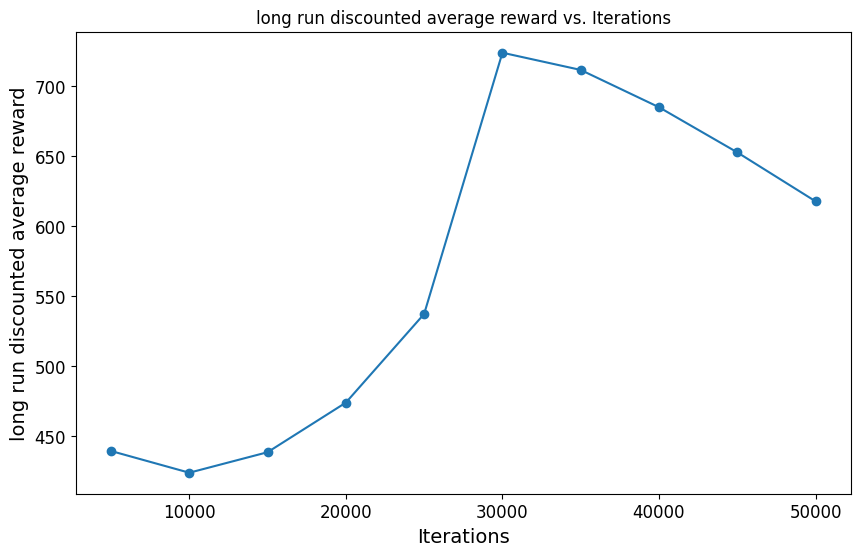

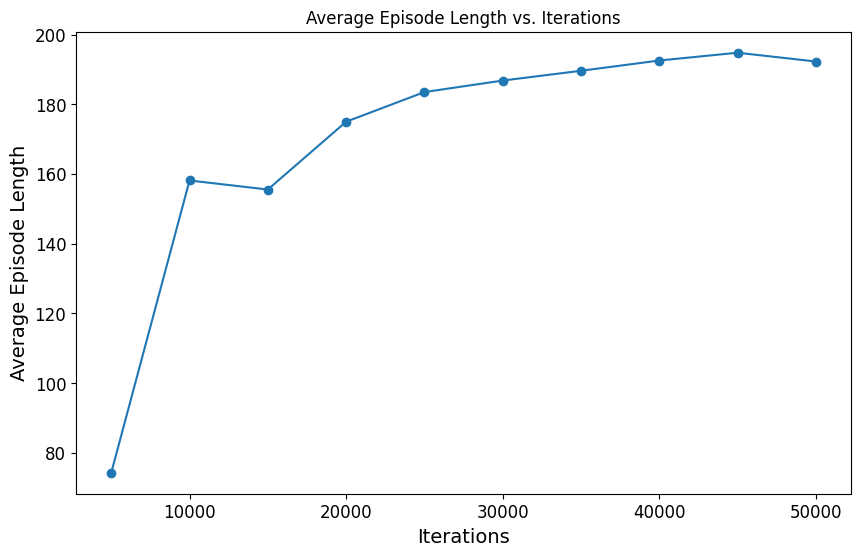

In [44]:
import matplotlib.pyplot as plt

iterations = [5000, 10000, 15000, 20000, 25000, 30000, 35000, 40000, 45000, 50000]
average_return = [439.6, 424.1, 438.73, 474.1, 537.36, 723.7, 711.42, 684.825, 652.62, 617.7]
average_episode_length = [74.22, 158.1, 155.5, 174.965, 183.476, 186.78, 189.59, 192.53, 194.77, 192.25]

# Plotting Average Return
plt.figure(figsize=(10, 6))
plt.plot(iterations, average_return, marker='o')
plt.xlabel('Iterations')
plt.ylabel('long run discounted average reward')
plt.title('long run discounted average reward vs. Iterations')

# Plotting Average Episode Length
plt.figure(figsize=(10, 6))
plt.plot(iterations, average_episode_length, marker='o')
plt.xlabel('Iterations')
plt.ylabel('Average Episode Length')
plt.title('Average Episode Length vs. Iterations')

plt.show()


In [34]:
from tf_agents.utils import common

In [35]:

'''checkpoint_dir = os.path.join("checkpointer", 'checkpoint')
train_checkpointer = common.Checkpointer(
    ckpt_dir=checkpoint_dir,
    max_to_keep=1,
    agent=agent,
    policy=agent.policy,
    replay_buffer=replay_buffer,
    global_step=train_step
)'''

'checkpoint_dir = os.path.join("checkpointer", \'checkpoint\')\ntrain_checkpointer = common.Checkpointer(\n    ckpt_dir=checkpoint_dir,\n    max_to_keep=1,\n    agent=agent,\n    policy=agent.policy,\n    replay_buffer=replay_buffer,\n    global_step=train_step\n)'

In [36]:
#Poilcy Saver 
#policy_dir = os.path.join("Policysaver", 'policy')
#tf_policy_saver = policy_saver.PolicySaver(agent.policy)

In [37]:
train_env = tf_py_environment.TFPyEnvironment(env)

In [38]:
collect_steps_per_iteration = 100
replay_buffer_capacity = 100000

fc_layer_params = (100,)

batch_size = 64
learning_rate = 1e-3
log_interval = 5

num_eval_episodes = 10
eval_interval = 1000

In [39]:
#@title
replay_buffer = tf_uniform_replay_buffer.TFUniformReplayBuffer(
    data_spec=agent.collect_data_spec,
    batch_size=train_env.batch_size,
    max_length=replay_buffer_capacity)

collect_driver = dynamic_step_driver.DynamicStepDriver(
    train_env,
    agent.collect_policy,
    observers=[replay_buffer.add_batch],
    num_steps=collect_steps_per_iteration)

# Initial data collection
collect_driver.run()

# Dataset generates trajectories with shape [BxTx...] where
# T = n_step_update + 1.
dataset = replay_buffer.as_dataset(
    num_parallel_calls=3, sample_batch_size=batch_size,
    num_steps=2).prefetch(3)

iterator = iter(dataset)

In [40]:
train_checkpointer.save(train_step)

NameError: name 'train_checkpointer' is not defined

In [ ]:
#@title
def embed_gif(gif_buffer):
  """Embeds a gif file in the notebook."""
  tag = ''.format(base64.b64encode(gif_buffer).decode())
  return IPython.display.HTML(tag)

def run_episodes_and_create_video(policy, eval_tf_env, eval_py_env):
  num_episodes = 3
  frames = []
  for _ in range(num_episodes):
    time_step = eval_tf_env.reset()
    frames.append(eval_py_env.render())
    while not time_step.is_last():
      action_step = policy.action(time_step)
      time_step = eval_tf_env.step(action_step.action)
      frames.append(eval_py_env.render())
  gif_file = io.BytesIO()
  imageio.mimsave(gif_file, frames, format='gif', fps=60)
  IPython.display.display(embed_gif(gif_file.getvalue()))

In [ ]:
eval_env = tf_py_environment.TFPyEnvironment(env)

In [ ]:

train_checkpointer.initialize_or_restore()
global_step = tf.compat.v1.train.get_global_step()

In [ ]:

tf_policy_saver.save(policy_dir)

In [ ]:
import io
import imageio
import IPython
import base64
saved_policy = tf.saved_model.load(policy_dir)
run_episodes_and_create_video(saved_policy, eval_env, env) 